<h1 style="font-family: 'Helvetica'; font-size: 38px; font-weight: bold; color: #343434; padding: 8px; margin-bottom: 20px; text-align: center; letter-spacing: 1px;">🎨Text-to-Image with Stable Diffusion👨🏼‍💻</h1><br>
<center><img src = "https://r2.stablediffusionweb.com/images/stable-diffusion-demo-1.webp"></center>

In [2]:
# Installing diffusers library
!pip install diffusers

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 10.5 MB/s eta 0:00:00


<p style="font-family: 'Helvetica'; font-size: 22px; color: #343434; padding: 8px; margin-bottom: 20px; text-align: left; letter-spacing: 1px;">We may now import all relevant libraries</p>

In [3]:
# Library imports

# Importing PyTorch library, for building and training neural networks
import torch

# Importing the CLIP Model
from transformers import CLIPProcessor, CLIPModel

# Importing StableDiffusionPipeline to use pre-trained Stable Diffusion models
from diffusers import StableDiffusionPipeline

# Image is a class for the PIL module to visualize images in a Python Notebook
from PIL import Image

/usr/local/lib/python3.10/dist-packages/diffusers/models/transformers/transformer_2d.py:34: FutureWarning: `Transformer2DModelOutput` is deprecated and will be removed in version 1.0.0. Importing `Transformer2DModelOutput` from `diffusers.models.transformer_2d` is deprecated and this will be removed in a future version. Please use `from diffusers.models.modeling_outputs import Transformer2DModelOutput`, instead.
  deprecate("Transformer2DModelOutput", "1.0.0", deprecation_message)


<p style="font-family: 'Helvetica'; font-size: 22px; color: #343434; padding: 8px; margin-bottom: 20px; text-align: left; letter-spacing: 1px;">Let's create an instance of the pipeline.<br><br>
The <code>.from_pretrained("CompVis/stable-diffusion-v1-4")</code> will initialize the diffusion model with pre-trained weights and settings, as well a pre-trained VAE, U-Net, and text encoder to generate images from text.<br><br>
The <code>torch_dtype = torch.float16</code> sets the datatype of the model to float16, a lower-precision floating-point format, to help speed up inference.</p>

In [4]:
# Creating pipeline
pipeline = StableDiffusionPipeline.from_pretrained("CompVis/stable-diffusion-v1-4",
                                                  torch_dtype=torch.float16)

Cannot initialize model with low cpu memory usage because `accelerate` was not found in the environment. Defaulting to `low_cpu_mem_usage=False`. It is strongly recommended to install `accelerate` for faster and less memory-intense model loading. You can do so with: 
```
pip install accelerate
```
.
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

model.safetensors:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/313 [00:00<?, ?B/s]

(…)kpoints/scheduler_config-checkpoint.json:   0%|          | 0.00/209 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

(…)ature_extractor/preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

safety_checker/config.json:   0%|          | 0.00/4.56k [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/592 [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/551 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

<p style="font-family: 'Helvetica'; font-size: 22px; color: #343434; padding: 8px; margin-bottom: 20px; text-align: left; letter-spacing: 1px;">Now, we may define a function that is going to create and display a grid of images generated with Stable Diffusion.</p>

In [5]:
# Defining function for the creation of a grid of images
def image_grid(imgs, rows, cols):
    assert len(imgs) == rows*cols

    w, h = imgs[0].size
    grid = Image.new('RGB', size = (cols*w,
                                   rows * w))
    grid_w, grid_h = grid.size

    for i, img in enumerate(imgs):
        grid.paste(img, box = (i%cols*w, i // cols*h))
    return grid

<p style="font-family: 'Helvetica'; font-size: 22px; color: #343434; padding: 8px; margin-bottom: 20px; text-align: left; letter-spacing: 1px;">Next, we use PyTorch's <code>to</code> method to move our pipeline to the GPU, which speed up the training and inference of neural networks.</p>

In [6]:
# Moving pipeline to GPU
pipeline = pipeline.to('cuda')

<p style="font-family: 'Helvetica'; font-size: 22px; color: #343434; padding: 8px; margin-bottom: 20px; text-align: left; letter-spacing: 1px;">Now, we can finally use Stable Diffusion to generate images from text!<br><br>
In the code below, <code>n_images</code> is used to define how many images will be generated. Whereas <code>prompt</code> is the text that is going to be used to generate the images we would like to generate.</p>

  0%|          | 0/50 [00:00<?, ?it/s]

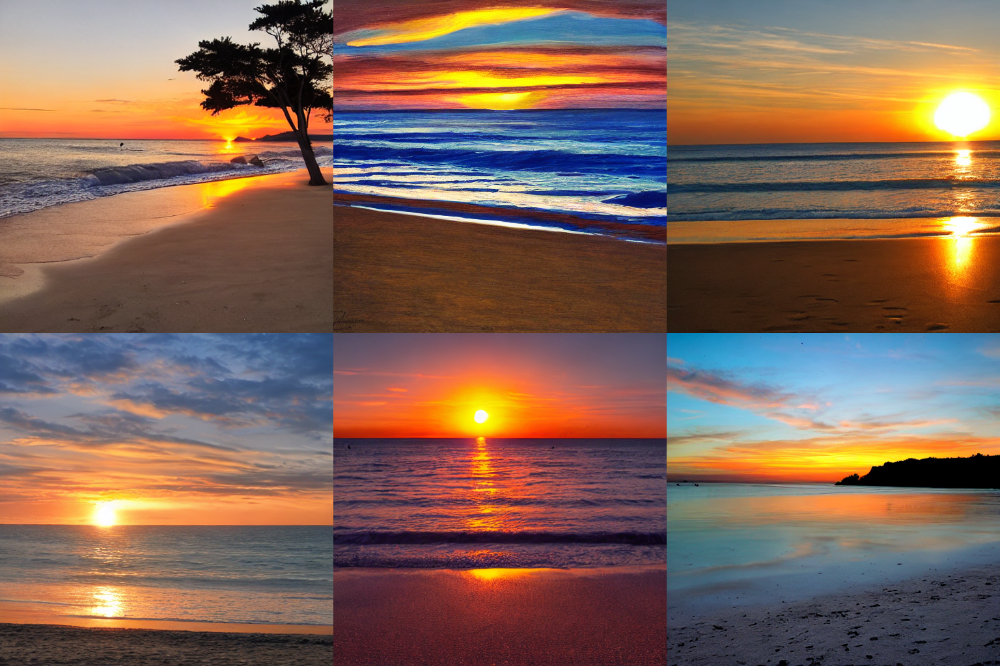

In [7]:
n_images = 6 # Let's generate 6 images based on the prompt below
prompt = ['Sunset on a beach'] * n_images

images = pipeline(prompt).images

grid = image_grid(images, rows=2, cols = 3)
grid

# **Calculating CLIP Score **

In [8]:
# Initialize CLIP model and processor
clip_model_id = "openai/clip-vit-base-patch32"
clip_model = CLIPModel.from_pretrained(clip_model_id).to("cuda").eval()
clip_processor = CLIPProcessor.from_pretrained(clip_model_id)

# Preprocess images and text
image_inputs = clip_processor(images=images, return_tensors="pt", padding=True)
text_inputs = clip_processor(text=prompt, return_tensors="pt", padding=True)

# Move image tensors to the correct device and dtype
image_inputs = {k: v.to("cuda", dtype=torch.float16) for k, v in image_inputs.items()}

# Move text tensors to the correct device (indices should be torch.long)
text_inputs = {k: v.to("cuda") for k, v in text_inputs.items()}
text_inputs["input_ids"] = text_inputs["input_ids"].to(torch.long)
text_inputs["attention_mask"] = text_inputs["attention_mask"].to(torch.long)

# Get image and text embeddings
with torch.no_grad():
    image_embeddings = clip_model.get_image_features(**image_inputs)
    text_embeddings = clip_model.get_text_features(**text_inputs)

# Calculate cosine similarities
cosine_similarities = torch.nn.functional.cosine_similarity(image_embeddings, text_embeddings)

# Average CLIP score
clip_score = cosine_similarities.mean().item()
print(f"Average CLIP Score: {clip_score}")

config.json:   0%|          | 0.00/4.19k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/605M [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/316 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/592 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/862k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/2.22M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

Average CLIP Score: 0.2834375500679016


  0%|          | 0/50 [00:00<?, ?it/s]

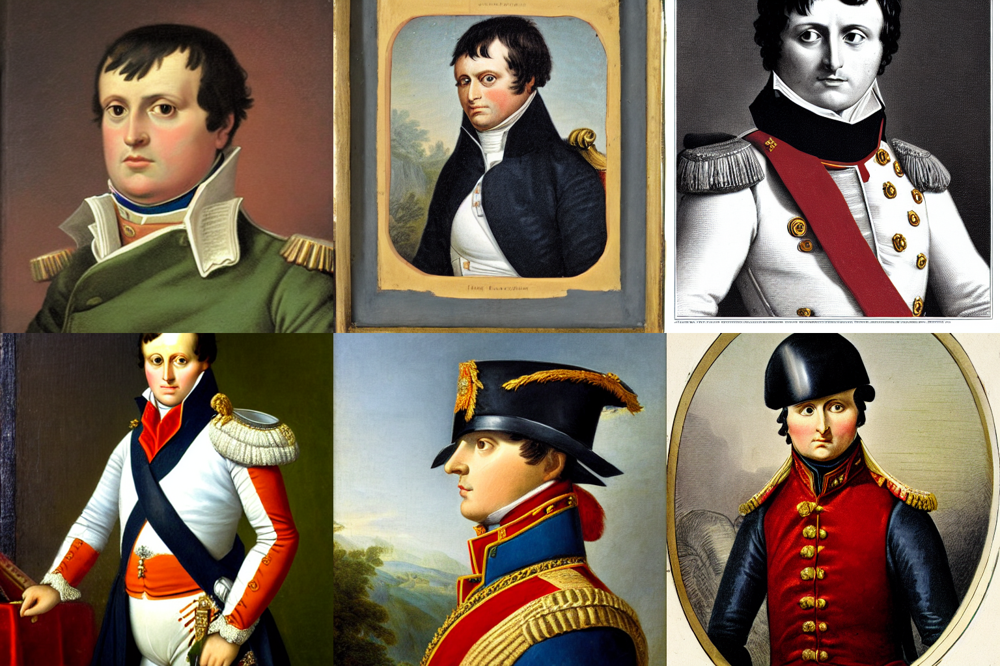

In [9]:
n_images = 6
prompt = ['Portrait of Napoleon Bonaparte'] * n_images

images = pipeline(prompt).images

grid = image_grid(images, rows=2, cols = 3)
grid

# **Calculating CLIP Score **

In [10]:
# Initialize CLIP model and processor
clip_model_id = "openai/clip-vit-base-patch32"
clip_model = CLIPModel.from_pretrained(clip_model_id).to("cuda").eval()
clip_processor = CLIPProcessor.from_pretrained(clip_model_id)

# Preprocess images and text
image_inputs = clip_processor(images=images, return_tensors="pt", padding=True)
text_inputs = clip_processor(text=prompt, return_tensors="pt", padding=True)

# Move image tensors to the correct device and dtype
image_inputs = {k: v.to("cuda", dtype=torch.float16) for k, v in image_inputs.items()}

# Move text tensors to the correct device (indices should be torch.long)
text_inputs = {k: v.to("cuda") for k, v in text_inputs.items()}
text_inputs["input_ids"] = text_inputs["input_ids"].to(torch.long)
text_inputs["attention_mask"] = text_inputs["attention_mask"].to(torch.long)

# Get image and text embeddings
with torch.no_grad():
    image_embeddings = clip_model.get_image_features(**image_inputs)
    text_embeddings = clip_model.get_text_features(**text_inputs)

# Calculate cosine similarities
cosine_similarities = torch.nn.functional.cosine_similarity(image_embeddings, text_embeddings)

# Average CLIP score
clip_score = cosine_similarities.mean().item()
print(f"Average CLIP Score: {clip_score}")

Average CLIP Score: 0.342689573764801


  0%|          | 0/50 [00:00<?, ?it/s]

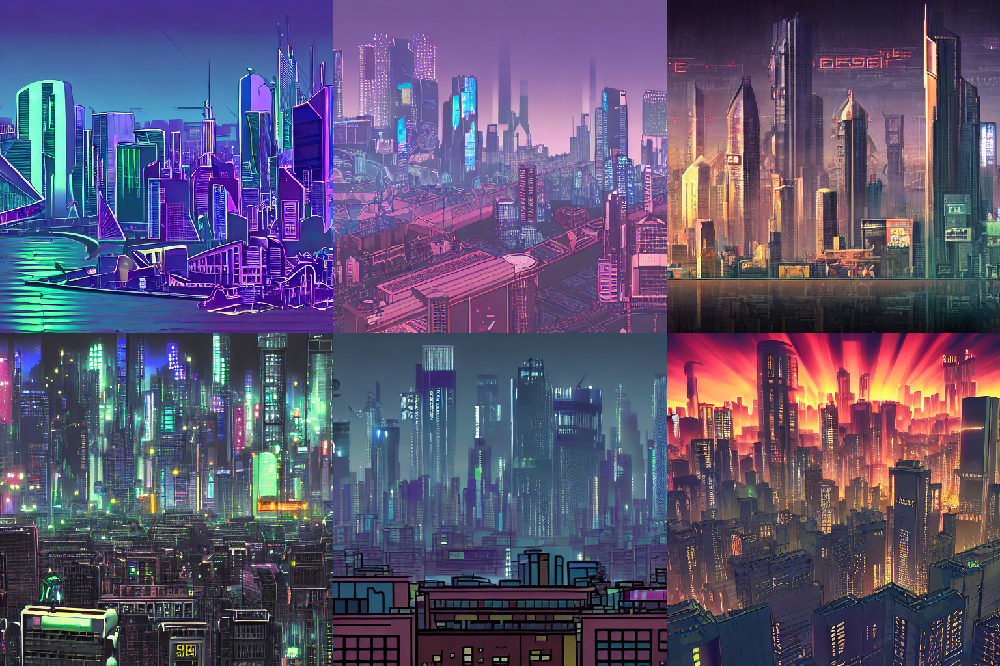

In [ ]:
n_images = 6
prompt = ['Skyline of a cyberpunk megalopolis'] * n_images

images = pipeline(prompt).images

grid = image_grid(images, rows=2, cols = 3)
grid

# **Calculating CLIP Score **

In [ ]:
# Initialize CLIP model and processor
clip_model_id = "openai/clip-vit-base-patch32"
clip_model = CLIPModel.from_pretrained(clip_model_id).to("cuda").eval()
clip_processor = CLIPProcessor.from_pretrained(clip_model_id)

# Preprocess images and text
image_inputs = clip_processor(images=images, return_tensors="pt", padding=True)
text_inputs = clip_processor(text=prompt, return_tensors="pt", padding=True)

# Move image tensors to the correct device and dtype
image_inputs = {k: v.to("cuda", dtype=torch.float16) for k, v in image_inputs.items()}

# Move text tensors to the correct device (indices should be torch.long)
text_inputs = {k: v.to("cuda") for k, v in text_inputs.items()}
text_inputs["input_ids"] = text_inputs["input_ids"].to(torch.long)
text_inputs["attention_mask"] = text_inputs["attention_mask"].to(torch.long)

# Get image and text embeddings
with torch.no_grad():
    image_embeddings = clip_model.get_image_features(**image_inputs)
    text_embeddings = clip_model.get_text_features(**text_inputs)

# Calculate cosine similarities
cosine_similarities = torch.nn.functional.cosine_similarity(image_embeddings, text_embeddings)

# Average CLIP score
clip_score = cosine_similarities.mean().item()
print(f"Average CLIP Score: {clip_score}")

Average CLIP Score: 0.32319164276123047


  0%|          | 0/50 [00:00<?, ?it/s]

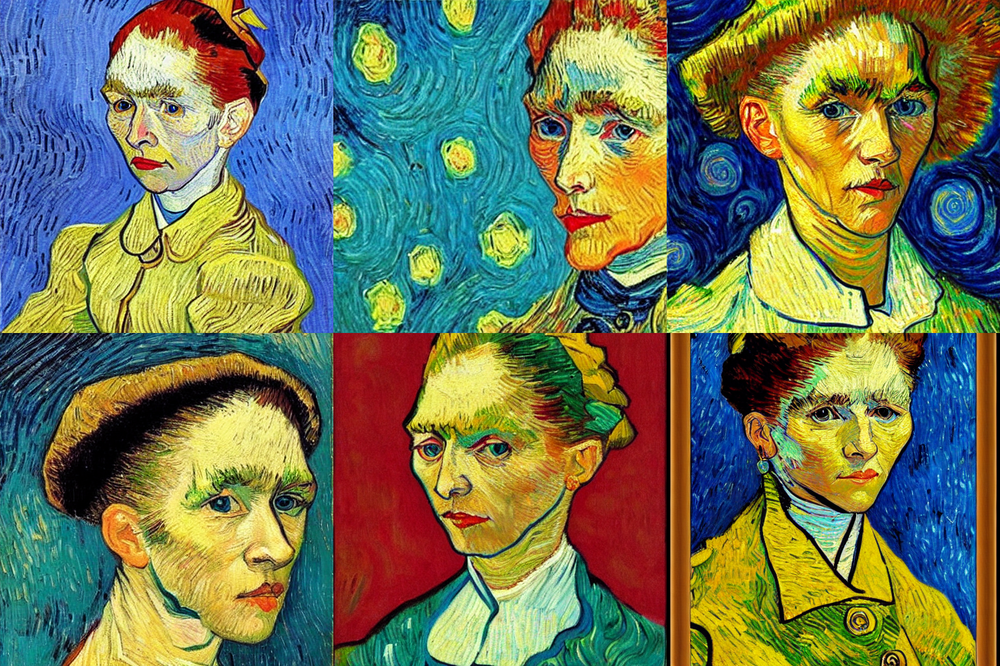

In [ ]:
n_images = 6
prompt = ['Painting of a woman in the style of Van Gogh'] * n_images

images = pipeline(prompt).images

grid = image_grid(images, rows=2, cols = 3)
grid

# **Calculating CLIP Score **

In [ ]:
# Initialize CLIP model and processor
clip_model_id = "openai/clip-vit-base-patch32"
clip_model = CLIPModel.from_pretrained(clip_model_id).to("cuda").eval()
clip_processor = CLIPProcessor.from_pretrained(clip_model_id)

# Preprocess images and text
image_inputs = clip_processor(images=images, return_tensors="pt", padding=True)
text_inputs = clip_processor(text=prompt, return_tensors="pt", padding=True)

# Move image tensors to the correct device and dtype
image_inputs = {k: v.to("cuda", dtype=torch.float16) for k, v in image_inputs.items()}

# Move text tensors to the correct device (indices should be torch.long)
text_inputs = {k: v.to("cuda") for k, v in text_inputs.items()}
text_inputs["input_ids"] = text_inputs["input_ids"].to(torch.long)
text_inputs["attention_mask"] = text_inputs["attention_mask"].to(torch.long)

# Get image and text embeddings
with torch.no_grad():
    image_embeddings = clip_model.get_image_features(**image_inputs)
    text_embeddings = clip_model.get_text_features(**text_inputs)

# Calculate cosine similarities
cosine_similarities = torch.nn.functional.cosine_similarity(image_embeddings, text_embeddings)

# Average CLIP score
clip_score = cosine_similarities.mean().item()
print(f"Average CLIP Score: {clip_score}")

Average CLIP Score: 0.3454342782497406


  0%|          | 0/50 [00:00<?, ?it/s]

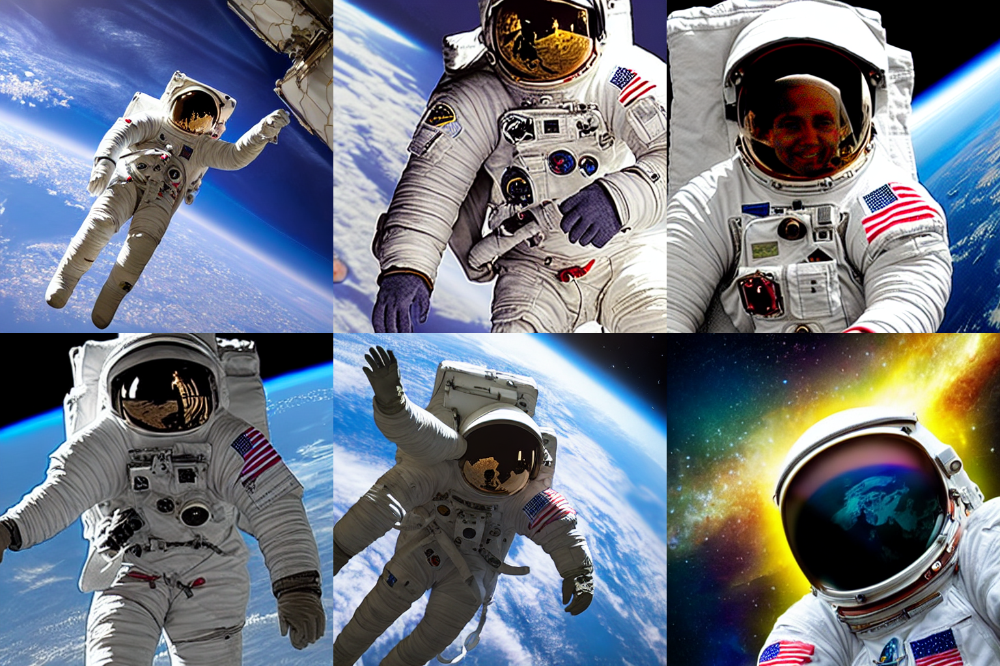

In [ ]:
n_images = 6
prompt = ['Picture of an astronaut in space'] * n_images

images = pipeline(prompt).images

grid = image_grid(images, rows=2, cols = 3)
grid

# **Calculating CLIP Score **

In [ ]:
# Initialize CLIP model and processor
clip_model_id = "openai/clip-vit-base-patch32"
clip_model = CLIPModel.from_pretrained(clip_model_id).to("cuda").eval()
clip_processor = CLIPProcessor.from_pretrained(clip_model_id)

# Preprocess images and text
image_inputs = clip_processor(images=images, return_tensors="pt", padding=True)
text_inputs = clip_processor(text=prompt, return_tensors="pt", padding=True)

# Move image tensors to the correct device and dtype
image_inputs = {k: v.to("cuda", dtype=torch.float16) for k, v in image_inputs.items()}

# Move text tensors to the correct device (indices should be torch.long)
text_inputs = {k: v.to("cuda") for k, v in text_inputs.items()}
text_inputs["input_ids"] = text_inputs["input_ids"].to(torch.long)
text_inputs["attention_mask"] = text_inputs["attention_mask"].to(torch.long)

# Get image and text embeddings
with torch.no_grad():
    image_embeddings = clip_model.get_image_features(**image_inputs)
    text_embeddings = clip_model.get_text_features(**text_inputs)

# Calculate cosine similarities
cosine_similarities = torch.nn.functional.cosine_similarity(image_embeddings, text_embeddings)

# Average CLIP score
clip_score = cosine_similarities.mean().item()
print(f"Average CLIP Score: {clip_score}")

Average CLIP Score: 0.3056434988975525


  0%|          | 0/50 [00:00<?, ?it/s]

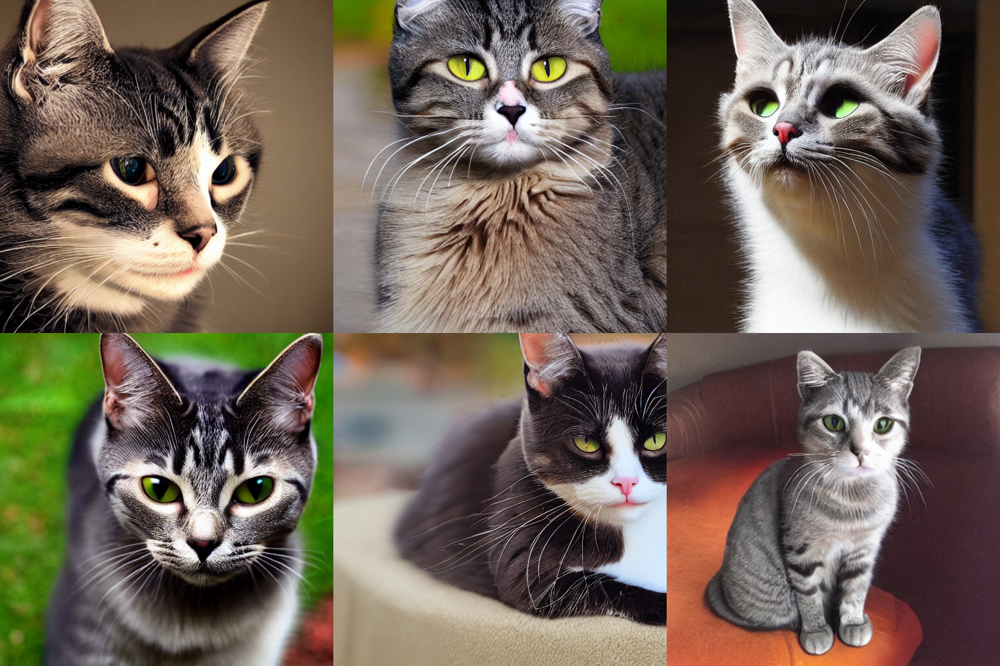

In [ ]:
n_images = 6
prompt = ['cat'] * n_images

images = pipeline(prompt).images

grid = image_grid(images, rows=2, cols = 3)
grid

# **Calculating CLIP Score **

In [ ]:
# Initialize CLIP model and processor
clip_model_id = "openai/clip-vit-base-patch32"
clip_model = CLIPModel.from_pretrained(clip_model_id).to("cuda").eval()
clip_processor = CLIPProcessor.from_pretrained(clip_model_id)

# Preprocess images and text
image_inputs = clip_processor(images=images, return_tensors="pt", padding=True)
text_inputs = clip_processor(text=prompt, return_tensors="pt", padding=True)

# Move image tensors to the correct device and dtype
image_inputs = {k: v.to("cuda", dtype=torch.float16) for k, v in image_inputs.items()}

# Move text tensors to the correct device (indices should be torch.long)
text_inputs = {k: v.to("cuda") for k, v in text_inputs.items()}
text_inputs["input_ids"] = text_inputs["input_ids"].to(torch.long)
text_inputs["attention_mask"] = text_inputs["attention_mask"].to(torch.long)

# Get image and text embeddings
with torch.no_grad():
    image_embeddings = clip_model.get_image_features(**image_inputs)
    text_embeddings = clip_model.get_text_features(**text_inputs)

# Calculate cosine similarities
cosine_similarities = torch.nn.functional.cosine_similarity(image_embeddings, text_embeddings)

# Average CLIP score
clip_score = cosine_similarities.mean().item()
print(f"Average CLIP Score: {clip_score}")

Average CLIP Score: 0.26492804288864136


  0%|          | 0/50 [00:00<?, ?it/s]

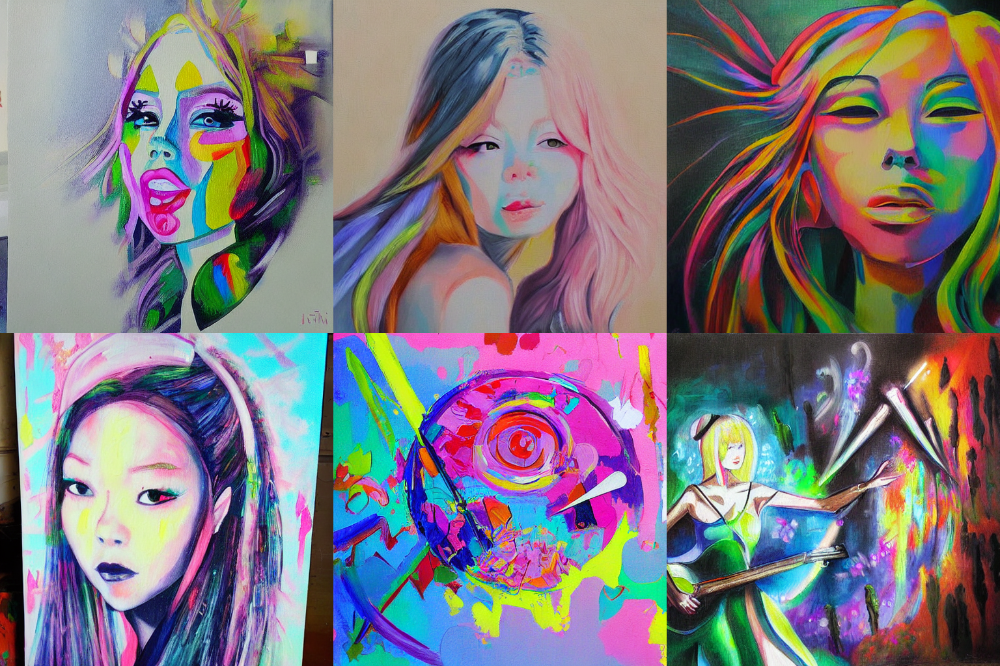

In [ ]:
n_images = 6
prompt = ['Artist ia painting'] * n_images

images = pipeline(prompt).images

grid = image_grid(images, rows=2, cols = 3)
grid

# **Calculating CLIP Score **

In [ ]:
# Initialize CLIP model and processor
clip_model_id = "openai/clip-vit-base-patch32"
clip_model = CLIPModel.from_pretrained(clip_model_id).to("cuda").eval()
clip_processor = CLIPProcessor.from_pretrained(clip_model_id)

# Preprocess images and text
image_inputs = clip_processor(images=images, return_tensors="pt", padding=True)
text_inputs = clip_processor(text=prompt, return_tensors="pt", padding=True)

# Move image tensors to the correct device and dtype
image_inputs = {k: v.to("cuda", dtype=torch.float16) for k, v in image_inputs.items()}

# Move text tensors to the correct device (indices should be torch.long)
text_inputs = {k: v.to("cuda") for k, v in text_inputs.items()}
text_inputs["input_ids"] = text_inputs["input_ids"].to(torch.long)
text_inputs["attention_mask"] = text_inputs["attention_mask"].to(torch.long)

# Get image and text embeddings
with torch.no_grad():
    image_embeddings = clip_model.get_image_features(**image_inputs)
    text_embeddings = clip_model.get_text_features(**text_inputs)

# Calculate cosine similarities
cosine_similarities = torch.nn.functional.cosine_similarity(image_embeddings, text_embeddings)

# Average CLIP score
clip_score = cosine_similarities.mean().item()
print(f"Average CLIP Score: {clip_score}")

Average CLIP Score: 0.27340167760849


<p style="font-family: 'Helvetica'; font-size: 22px; color: #343434; padding: 8px; margin-bottom: 20px; text-align: left; letter-spacing: 1px;">Thank you for reading!<br><br><br><br>
    <i>Luís Fernando Torres</i><br><br></p>
    <p style = "font-family: 'Helvetica', font-size: 18px; color: #343434; padding: 8px; margin-bottom: 20px; text-align: left; letter-spacing: 1px;"><a href = "https://www.linkedin.com/in/luuisotorres/">LinkedIn</a><br><br>
<a href = "https://medium.com/@luuisotorres">Medium</a></p>